# Data Exploration and Feature Engineering

# Feature Engineering:

### MMSI - ID : Maritime Mobile Service Identity (MMSI)?
Maritime Mobile Service Identity (MMSI) is a unique, 9-digit number assigned to a digital selective calling (DSC) radio. It acts as a digital fingerprint for vessels, making it easier for other boats and authorities to identify and communicate with a ship at sea quickly. The International Telecommunications Union (ITU) in Geneva allocates, manages, and regulates MMSIs. 

There are two parts to an MMSI number:

    1. The first three digits are the maritime identification digits (MID), identifying the country that issued the number.
    2. The last six digits are the Mobile Station Identifier (MSI), which can be any number from 0-9, and is unique to a vessel or radio.

### Base DateTime: Timestamp of recorded data.
### LAT, LON : Latitude and Longitude data GPS 
Geographic coordinate of the vessel’s position.
Lattitude Range: -90 to +90. Combine with LON for spatial analysis.  
Longitude Range: -180 to +180. May require conversion to projected coordinates for spatial modeling.

### SOG : Speed Over Ground (knots)
Actual vessel speed relative to the Earth’s surface (not water).
Used for motion modeling, trajectory smoothing, and behavior detection. Values can be 0 (anchored).

### COG : Course Over Ground
Vessel’s actual direction of movement over the ground (0–360°).
Key for heading prediction and route reconstruction. Discontinuity at 360°—may need angular unwrapping.

### Heading: Ship’s physical bow direction (°)
The orientation of the vessel’s hull relative to true north.
Can differ from COG due to drift (current, wind). Useful for identifying turning or maneuvering behavior.


### VesselName : 
Human-readable vessel name, often duplicated across AIS messages.
Useful for merging metadata (IMO, type) but not for modeling directly.

### IMO : IMO - Number
Permanent 7-digit ID assigned to the vessel (unlike MMSI, which may change).
Used for static metadata joins (e.g., vessel age, flag, owner).Permanent 7-digit ID assigned to the vessel (unlike MMSI, which may change).
Used for static metadata joins (e.g., vessel age, flag, owner).

### Call Sign 
Unique radio identifier used for communication.

### Vessel Type:  Numeric vessel type code
Encoded type, e.g. 70 = Cargo, 60 = Passenger, 80 = Tanker, etc.
Convert using AIS vessel type mapping tables (below). Useful for classification or filtering.

### Status: Navigation status code
Vessel’s operational state.
Common values: 0 = under way, 1 = at anchor, 5 = moored, 8 = under way sailing. Missing values possible.

### Draft:
Depth of vessel below waterline — depends on load.
Useful for cargo estimation, fuel consumption, or grounding risk.
### Length and Width
### Cargo:
### TransceiverClass:
Identifies transmitter equipment class.
A = Commercial (SOLAS vessels), B = Smaller recreational/costal. Important for message reliability.
 

In [2]:
pwd

'd:\\Maritime_Vessel_monitoring\\Maritime_analytics_AIS_System\\data_exploration'

### Data loading from csv format to pandas.DataFrame for easier handling.

We have got multiple AIS datasets stored in separate folders (each for a different date), and you want to automate reading them and assigning them meaningful names efficiently, rather than writing out each manually.

In [3]:
AIS_20_01_01_filepath = (
    r"D:\\Maritime_Vessel_monitoring\\csv_extracted_data\AIS_2020_01_01",
)
AIS_20_01_02_filepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_02",
)
AIS_20_01_03_filepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_03",
)
AIS_20_01_04_filepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_04",
)
AIS_20_01_05_filepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_05",
)
AIS_20_01_06_fiilepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_06",
)
AIS_20_01_07_fiilepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_07",
)
AIS_20_01_08_fiilepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_08",
)
AIS_20_01_09_fiilepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_09",
)
AIS_20_01_10_fiilepath = (
    r"D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_10"
)

import os
import pandas as pd
from glob import glob

# Base directory where your AIS folders are stored
BASE_DIR = r"D:\Maritime_Vessel_monitoring\csv_extracted_data"

# List of subfolder names or date suffixes
dates = [
    "2020_01_01",
    "2020_01_02",
    "2020_01_03",
    "2020_01_04",
    "2020_01_05",
    "2020_01_06",
    "2020_01_07",
    "2020_01_08",
    "2020_01_09",
    "2020_01_10",
]


# Function to dynamically read datasets and store them in a dictionary
def load_ais_datasets(base_dir, dates):
    datasets = {}

    for date in dates:
        folder_path = os.path.join(base_dir, f"AIS_{date}")

        # Find CSV files inside the folder
        csv_files = glob(os.path.join(folder_path, "*.csv"))

        if not csv_files:
            print(f"⚠️ No CSV files found in: {folder_path}")
            continue

        # Read all CSVs in the folder and combine them
        df_list = [pd.read_csv(file) for file in csv_files]
        combined_df = pd.concat(df_list, ignore_index=True)

        # Assign DataFrame with a dynamic variable-like name (inside dict)
        datasets[f"AIS_{date}"] = combined_df

        print(f"✅ Loaded AIS_{date} → {len(combined_df)} rows")

    return datasets


# Load all datasets
ais_datasets = load_ais_datasets(BASE_DIR, dates)

# Example: Access one dataset
AIS_2020_01_01 = ais_datasets["AIS_2020_01_01"]

In [ ]:
import pandas as pd

AIS_2020_01_01 = pd.read_csv(
    "D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_01\AIS_2020_01_01.csv"
)

<>:3: SyntaxWarning: invalid escape sequence '\M'
<>:3: SyntaxWarning: invalid escape sequence '\M'
C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1374680175.py:3: SyntaxWarning: invalid escape sequence '\M'
  AIS_2020_01_01 = pd.read_csv("D:\Maritime_Vessel_monitoring\csv_extracted_data\AIS_2020_01_01\AIS_2020_01_01.csv")


In [5]:
AIS_2020_01_01.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype  
---  ------            --------------    -----  
 0   MMSI              1048575 non-null  int64  
 1   BaseDateTime      1048575 non-null  object 
 2   LAT               1048575 non-null  float64
 3   LON               1048575 non-null  float64
 4   SOG               1048575 non-null  float64
 5   COG               1048575 non-null  float64
 6   Heading           1048575 non-null  int64  
 7   VesselName        957221 non-null   object 
 8   IMO               448711 non-null   object 
 9   CallSign          863249 non-null   object 
 10  VesselType        942832 non-null   float64
 11  Status            818750 non-null   float64
 12  Length            881202 non-null   float64
 13  Width             746223 non-null   float64
 14  Draft             255359 non-null   float64
 15  Cargo             295633 non-null   float64
 16  

In [6]:
AIS_2020_01_01.describe()

,MMSI,LAT,LON,SOG,COG,Heading,VesselType,Status,Length,Width,Draft,Cargo
count,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,1.048575e+06,942832.000000,818750.000000,881202.000000,746223.000000,255359.000000,295633.000000
mean,3.677646e+08,3.519408e+01,-9.620226e+01,2.067492e+00,2.067916e+02,3.658072e+02,43.824263,4.092843,48.467869,11.238863,6.264605,48.296398
std,5.776038e+07,8.325801e+00,2.044688e+01,5.661315e+00,1.105374e+02,1.778374e+02,19.697082,5.677249,64.838638,9.248288,4.371319,22.220168
min,1.100000e+01,3.027440e+00,-1.782741e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,-12.800000,0.000000
25%,3.669196e+08,2.961422e+01,-1.171667e+02,0.000000e+00,1.169000e+02,2.130000e+02,31.000000,0.000000,18.000000,6.000000,3.200000,31.000000
50%,3.673909e+08,3.271150e+01,-9.037544e+01,0.000000e+00,2.282000e+02,5.110000e+02,31.000000,0.000000,24.000000,8.000000,4.600000,52.000000
75%,3.677084e+08,4.051313e+01,-8.095832e+01,6.000000e-01,2.958000e+02,5.110000e+02,60.000000,5.000000,40.000000,12.000000,9.500000,60.000000
max,1.073709e+09,6.124122e+01,-6.281840e+01,1.023000e+02,3.600000e+02,5.110000e+02,99.000000,15.000000,367.000000,126.000000,24.100000,132.000000


In [ ]:
print(len(AIS_2020_01_01["MMSI"].unique()))
print(len(AIS_2020_01_01["IMO"].unique()))
print(len(AIS_2020_01_01["VesselType"].unique()))
print(len(AIS_2020_01_01["Status"].unique()))

print(len(AIS_2020_01_01["BaseDateTime"]))

11822
3724
47
16
1048575


In [ ]:
AIS_2020_01_01["BaseDateTime"] = pd.to_datetime(
    AIS_2020_01_01["BaseDateTime"],
    format="%Y-%m-%dT%H:%M:%S",  # our data’s format: YYYY-MM-DDTHH:MM:SS
    errors="coerce",
)

AIS_2020_01_01

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TransceiverClass
0,538008468,2020-01-01 00:00:00,38.25802,-76.29487,14.9,338.6,337,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,A
1,368120510,2020-01-01 00:00:00,27.58610,-82.75991,0.0,58.6,511,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,A
2,368063930,2020-01-01 00:00:00,40.71045,-73.97588,11.2,208.9,207,NaN,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,A
3,368106220,2020-01-01 00:00:00,38.53932,-90.25523,0.2,161.8,31,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,A
4,367336180,2020-01-01 00:00:00,56.02945,-132.68705,9.0,325.5,511,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,368108120,2020-01-01 04:13:51,35.25534,-90.09801,4.6,339.4,340,PORTER J. FURLONG,NaN,WDK9974,31.0,0.0,264.0,16.0,3.0,31.0,A
1048571,367447530,2020-01-01 04:16:21,27.70220,-82.71770,0.1,154.3,511,SWEET MELISSA,NaN,WDF4063,37.0,NaN,14.0,4.0,NaN,NaN,B
1048572,367379540,2020-01-01 04:17:15,29.83253,-91.17663,3.6,325.9,511,EMMANUEL,NaN,WDE6384,31.0,0.0,21.0,9.0,NaN,57.0,A
1048573,366963050,2020-01-01 04:16:25,38.92215,-90.28195,4.7,271.8,511,DALE A HELLER,NaN,WDB8703,31.0,0.0,39.0,13.0,NaN,NaN,A


In [9]:
AIS_2020_01_01.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 17 columns):
 #   Column            Non-Null Count    Dtype         
---  ------            --------------    -----         
 0   MMSI              1048575 non-null  int64         
 1   BaseDateTime      1048575 non-null  datetime64[ns]
 2   LAT               1048575 non-null  float64       
 3   LON               1048575 non-null  float64       
 4   SOG               1048575 non-null  float64       
 5   COG               1048575 non-null  float64       
 6   Heading           1048575 non-null  int64         
 7   VesselName        957221 non-null   object        
 8   IMO               448711 non-null   object        
 9   CallSign          863249 non-null   object        
 10  VesselType        942832 non-null   float64       
 11  Status            818750 non-null   float64       
 12  Length            881202 non-null   float64       
 13  Width             746223 non-null   float6

In [ ]:
df = AIS_2020_01_01
# Find IMO numbers that appear more than once
duplicate_imos = df["IMO"][df["IMO"].notna()].value_counts()
duplicate_imos = duplicate_imos[duplicate_imos > 1].index.tolist()

print(f"Unique number of IMO - Number in the dataset :  {len(df['IMO'].unique())}")
print(f"Number of non-unique IMO numbers: {len(duplicate_imos)}")

Unique number of IMO - Number in the dataset :  3724
Number of non-unique IMO numbers: 3678


In [ ]:
# Filter full DataFrame where IMO is in the duplicate list
df_non_unique_imo = df[df["IMO"].isin(duplicate_imos)]

print("Shape of rows with non-unique IMO:", df_non_unique_imo.shape)

Shape of rows with non-unique IMO: (448666, 17)


In [ ]:
import pandas as pd

# 1️⃣ Sort the entire DataFrame by MMSI and datetime
AIS_2020_01_01_sorted = AIS_2020_01_01.sort_values(
    by=["MMSI", "BaseDateTime"], ascending=True
).reset_index(drop=True)

# 2️⃣ Group by MMSI
grouped_MMSI_01 = AIS_2020_01_01_sorted.groupby("MMSI")["BaseDateTime"]

# 3️⃣ Iterate over groups
for mmsi, times in grouped_MMSI_01:
    print("MMSI:", mmsi)
    print(times.head())  # first 5 timestamps for this vessel
    # remove break to loop over all vessels

MMSI: 11
0   2020-01-01 01:02:21
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 18
1   2020-01-01 00:00:28
2   2020-01-01 00:03:32
3   2020-01-01 00:06:32
4   2020-01-01 00:09:32
5   2020-01-01 00:12:31
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 4910
68   2020-01-01 00:03:05
69   2020-01-01 00:07:05
70   2020-01-01 00:24:45
71   2020-01-01 00:26:04
72   2020-01-01 00:28:45
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 270995
89   2020-01-01 00:00:03
90   2020-01-01 00:01:04
91   2020-01-01 00:02:05
92   2020-01-01 00:03:13
93   2020-01-01 00:04:23
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 507027
243   2020-01-01 00:00:08
244   2020-01-01 00:01:16
245   2020-01-01 00:02:27
246   2020-01-01 00:03:36
247   2020-01-01 00:04:47
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 1056261
397   2020-01-01 00:00:12
398   2020-01-01 00:01:22
399   2020-01-01 00:02:23
400   2020-01-01 00:03:31
401   2020-01-01 00:04:42
Name: BaseDateTime, dtype: datetime64[ns]
MMSI: 1193046
535   2020-

In [13]:
# Count how many timestamps per MMSI
count_per_vessel = grouped_MMSI_01.count()
count_per_vessel

MMSI
11              1
18             67
4910           21
270995        154
507027        154
             ... 
941206308      73
941207025      33
983192020       5
983192021       4
1073709206    154
Name: BaseDateTime, Length: 11822, dtype: int64

In [ ]:
# Get first and last timestamp per vessel
first_timestamp = grouped_MMSI_01.min()
last_timestamp = grouped_MMSI_01.max()

summary_df = pd.DataFrame(
    {
        "first_timestamp": first_timestamp,
        "last_timestamp": last_timestamp,
        "num_points": count_per_vessel,
    }
)
print(summary_df.head(250))

              first_timestamp      last_timestamp  num_points
MMSI                                                         
11        2020-01-01 01:02:21 2020-01-01 01:02:21           1
18        2020-01-01 00:00:28 2020-01-01 04:15:36          67
4910      2020-01-01 00:03:05 2020-01-01 04:10:24          21
270995    2020-01-01 00:00:03 2020-01-01 04:11:04         154
507027    2020-01-01 00:00:08 2020-01-01 04:16:06         154
...                       ...                 ...         ...
246662000 2020-01-01 00:01:13 2020-01-01 04:13:17          71
246714000 2020-01-01 00:02:04 2020-01-01 04:11:03          60
246774000 2020-01-01 03:59:48 2020-01-01 04:13:17           5
246887000 2020-01-01 00:00:13 2020-01-01 04:13:14         143
247080700 2020-01-01 00:00:18 2020-01-01 01:28:27          16

[250 rows x 3 columns]


In [ ]:
import pandas as pd

# 1️⃣ Sort the entire DataFrame by MMSI and datetime
AIS_2020_01_01_sorted = AIS_2020_01_01.sort_values(
    by=["MMSI", "BaseDateTime"], ascending=True
).reset_index(drop=True)

# 2️⃣ Group by MMSI
grouped_MMSI_01 = AIS_2020_01_01_sorted.groupby("MMSI")["BaseDateTime"]

# 3️⃣ Iterate over groups
for mmsi, times in grouped_MMSI_01:
    print("MMSI:", mmsi)
    print(times.head())  # first 5 timestamps for this vessel
    break

MMSI: 11
0   2020-01-01 01:02:21
Name: BaseDateTime, dtype: datetime64[ns]


In [ ]:
# 1️⃣ Sort the entire DataFrame by MMSI and BaseDateTime
AIS_2020_01_01_sorted = AIS_2020_01_01.sort_values(
    by=["MMSI", "BaseDateTime"], ascending=True
).reset_index(drop=True)

# 2️⃣ Group by MMSI
grouped_MMSI_01 = AIS_2020_01_01_sorted.groupby("MMSI")
print(grouped_MMSI_01)

# 3️⃣ Iterate over groups and keep all features
vessel_dict = {}  # store each vessel's full dataframe

for mmsi, group in grouped_MMSI_01:
    # The group is already sorted by BaseDateTime
    vessel_dict[mmsi] = group.reset_index(drop=True)

""" 

Optional:
for mmsi, group in vessel_dict.items():
    group.to_csv(f"vessel_{mmsi}.csv", index=False)
"""

' \n\nOptional:\nfor mmsi, group in vessel_dict.items():\n    group.to_csv(f"vessel_{mmsi}.csv", index=False)\n'

In [ ]:
# vessel_dict

# EDA

### 1. Nature of the Data

Your AIS dataset (LAT, LON, SOG, COG, Heading, BaseDateTime, MMSI, VesselType, etc.) represents spatiotemporal trajectories — time-dependent geographic data.

So, your EDA will mix:

Temporal analysis → how features change over time

Spatial analysis → how positions are distributed geographically

Kinematic analysis → how vessels move (speed, course, heading)




| Category                   | Objective                                                  | Example Visualization                             |
| -------------------------- | ---------------------------------------------------------- | ------------------------------------------------- |
| **Spatial Distribution**   | Where are vessels mostly located? (ports, regions, routes) | Heatmaps, KDE, scatter on Folium or Plotly Mapbox |
| **Temporal Activity**      | When are vessels active? (hourly, daily, weekly cycles)    | Time histograms, boxplots vs time of day          |
| **Speed/Heading Patterns** | Identify navigation trends                                 | Histograms, polar plots, 2D density               |
| **Vessel Type Behavior**   | Compare cargo, tanker, fishing vessels                     | Grouped boxplots, facet maps                      |
| **Trajectory Continuity**  | Check gaps and interpolation quality                       | Line plots, missing data ratios                   |


###
A. Spatial Analysis

Latitude/Longitude Density (Global)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

all_data = pd.concat(vessel_dict.values(), ignore_index=True)

In [19]:
all_data

,MMSI,BaseDateTime,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,VesselType,Status,Length,Width,Draft,Cargo,TransceiverClass
0,11,2020-01-01 01:02:21,27.29223,-90.96779,0.0,234.4,511,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,A
1,18,2020-01-01 00:00:28,27.85057,-97.23631,0.0,215.1,511,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,A
2,18,2020-01-01 00:03:32,27.85055,-97.23627,0.0,201.0,511,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,A
3,18,2020-01-01 00:06:32,27.85056,-97.23627,0.0,189.3,511,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,A
4,18,2020-01-01 00:09:32,27.85054,-97.23624,0.0,193.6,511,NaN,NaN,NaN,NaN,5.0,NaN,NaN,NaN,NaN,A
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,1073709206,2020-01-01 04:08:40,29.94072,-91.84221,0.0,346.9,511,RAM 14,IMO8765072,WDA6950,90.0,0.0,26.0,13.0,0.0,90.0,A
1048571,1073709206,2020-01-01 04:09:43,29.94075,-91.84231,0.0,332.1,511,RAM 14,IMO8765072,WDA6950,90.0,0.0,26.0,13.0,0.0,90.0,A
1048572,1073709206,2020-01-01 04:10:49,29.94076,-91.84231,0.0,321.7,511,RAM 14,IMO8765072,WDA6950,90.0,0.0,26.0,13.0,0.0,90.0,A
1048573,1073709206,2020-01-01 04:12:30,29.94076,-91.84231,0.0,327.9,511,RAM 14,IMO8765072,WDA6950,90.0,0.0,26.0,13.0,0.0,90.0,A


In [ ]:
from folium.plugins import HeatMap
import folium

m = folium.Map(location=[all_data["LAT"].mean(), all_data["LON"].mean()], zoom_start=5)
heat_data = list(zip(all_data["LAT"], all_data["LON"]))
HeatMap(heat_data, radius=5).add_to(m)
m.save("outputs/heatmap_positions_2020_01_01.html")

B. Temporal Patterns


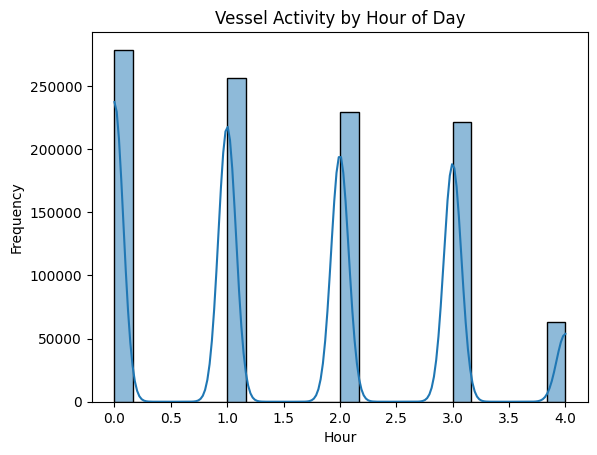

In [ ]:
all_data["hour"] = all_data["BaseDateTime"].dt.hour
sns.histplot(all_data["hour"], bins=24, kde=True)
plt.title("Vessel Activity by Hour of Day")
plt.xlabel("Hour")
plt.ylabel("Frequency")
plt.show()

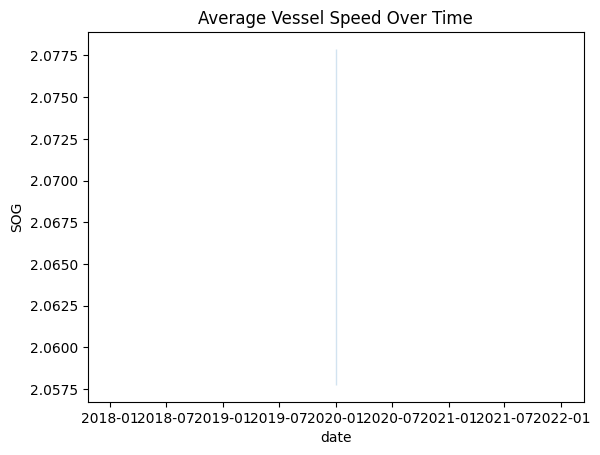

In [ ]:
all_data["date"] = all_data["BaseDateTime"].dt.date
sns.lineplot(data=all_data, x="date", y="SOG", estimator="mean")
plt.title("Average Vessel Speed Over Time")
plt.show()

### C . Kinematic Analysis

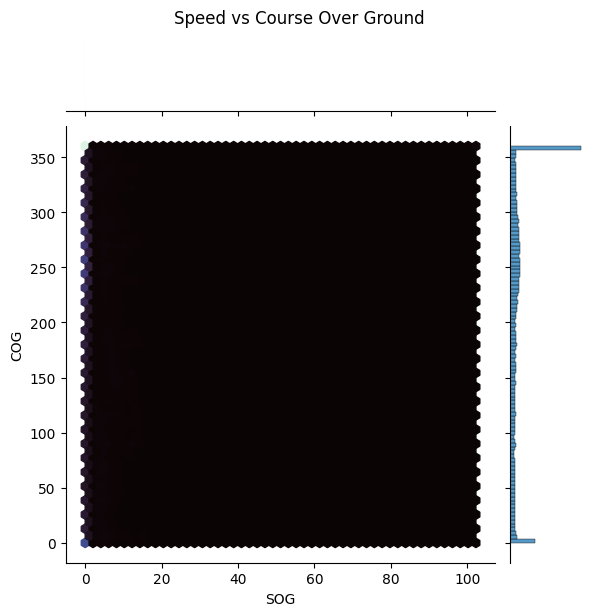

In [ ]:
sns.jointplot(data=all_data, x="SOG", y="COG", kind="hex", cmap="mako")
plt.suptitle("Speed vs Course Over Ground", y=1.02)
plt.show()

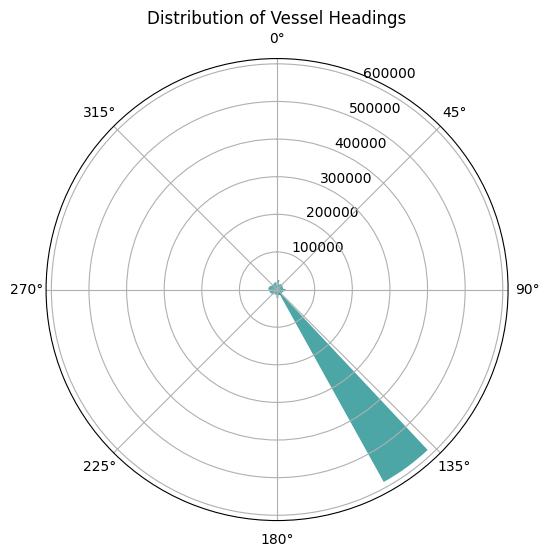

In [ ]:
import numpy as np

headings = np.deg2rad(all_data["Heading"].dropna())
plt.figure(figsize=(6, 6))
ax = plt.subplot(111, polar=True)
ax.hist(headings, bins=36, color="teal", alpha=0.7)
ax.set_theta_zero_location("N")
ax.set_theta_direction(-1)
plt.title("Distribution of Vessel Headings")
plt.show()

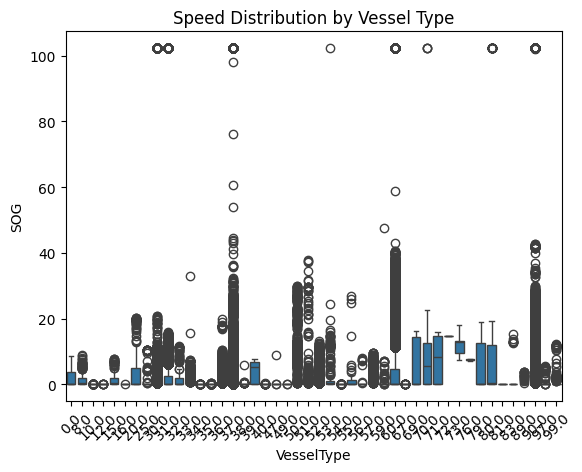

In [ ]:
sns.boxplot(data=all_data, x="VesselType", y="SOG")
plt.title("Speed Distribution by Vessel Type")
plt.xticks(rotation=45)
plt.show()

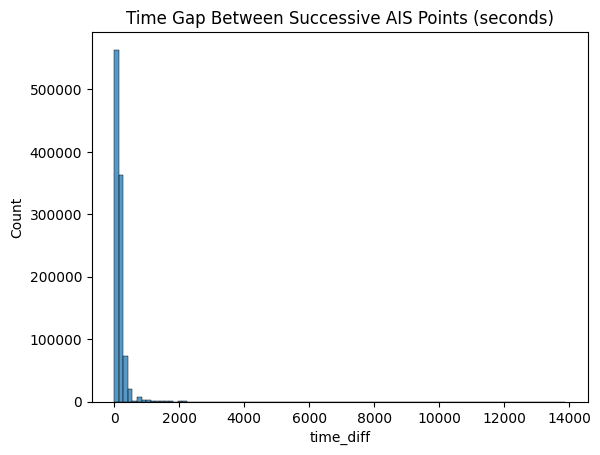

In [ ]:
all_data["time_diff"] = (
    all_data.groupby("MMSI")["BaseDateTime"].diff().dt.total_seconds()
)
sns.histplot(all_data["time_diff"].dropna(), bins=100)
plt.title("Time Gap Between Successive AIS Points (seconds)")
plt.show()

In [ ]:
import os

os.makedirs("outputs/eda", exist_ok=True)

In [ ]:
import pandas as pd

# Concatenate data
all_data = pd.concat(
    [df.reset_index(drop=True) for df in vessel_dict.values()], ignore_index=True
)

# Ensure datetime
all_data["BaseDateTime"] = pd.to_datetime(all_data["BaseDateTime"])

# Step 1: Check for duplicates (optional)
duplicates = all_data[all_data.duplicated(subset=["MMSI", "BaseDateTime"], keep=False)]
print(duplicates)

# Step 2: Handle duplicates (choose one method)
# Option 1: Remove duplicates (keep the first occurrence)
all_data = all_data.drop_duplicates(subset=["MMSI", "BaseDateTime"])

# Option 2: Aggregate duplicates
# all_data = all_data.groupby(['MMSI', 'BaseDateTime']).mean().reset_index()

# Step 3: Resample the data
all_data_sample = (
    all_data.set_index("BaseDateTime")
    .groupby("MMSI")
    .resample("1T")
    .nearest()
    .reset_index(level=0, drop=True)
    .reset_index()
    .dropna(subset=["LAT", "LON"])
)

              MMSI        BaseDateTime       LAT        LON   SOG    COG  \
1555     122292919 2020-01-01 02:00:00  32.69718 -117.23277   8.8  175.5   
1556     122292919 2020-01-01 02:00:00  32.69718 -117.23277   8.8  175.5   
5331     212911000 2020-01-01 01:00:00  49.28920 -123.06810   0.0  285.4   
5332     212911000 2020-01-01 01:00:00  49.28920 -123.06810   0.0  285.4   
5348     212911000 2020-01-01 02:00:00  49.28919 -123.06806   0.0  285.4   
...            ...                 ...       ...        ...   ...    ...   
1027759  565807000 2020-01-01 01:00:00  32.08009 -117.43979  14.5  161.7   
1035033  636014194 2020-01-01 02:59:59  29.06598  -75.61439  13.7   45.0   
1035034  636014194 2020-01-01 02:59:59  29.06598  -75.61439  13.7   45.0   
1041903  636018142 2020-01-01 03:00:00  31.17992 -118.12963  11.7   78.5   
1041904  636018142 2020-01-01 03:00:00  31.17992 -118.12963  11.7   78.5   

         Heading      VesselName         IMO CallSign  VesselType  Status  \
1555      

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\833659985.py:24: FutureWarning: 'T' is deprecated and will be removed in a future version, please use 'min' instead.
  .resample('1T')
C:\Users\amans\AppData\Local\Temp\ipykernel_28536\833659985.py:25: FutureWarning: DataFrameGroupBy.resample operated on the grouping columns. This behavior is deprecated, and in a future version of pandas the grouping columns will be excluded from the operation. Either pass `include_groups=False` to exclude the groupings or explicitly select the grouping columns after groupby to silence this warning.
  .nearest()


In [ ]:
import plotly.express as px

# reduce frames: bin to minute string to avoid too many frames
all_data_sample["time_str"] = all_data_sample["BaseDateTime"].dt.strftime(
    "%Y-%m-%d %H:%M"
)

fig = px.scatter_mapbox(
    all_data_sample,
    lat="LAT",
    lon="LON",
    color="MMSI",
    size_max=6,
    zoom=4,
    hover_data=["MMSI", "VesselName", "SOG"],
    animation_frame="time_str",
    height=700,
    title="Vessel positions over time (1-min bins)",
)
fig.update_layout(mapbox_style="open-street-map")
fig.write_html("outputs/eda/plotly_vessels_animation.html", auto_open=False)

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\526466719.py:6: DeprecationWarning: *scatter_mapbox* is deprecated! Use *scatter_map* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/
  fig = px.scatter_mapbox(


In [ ]:
import pydeck as pdk
import numpy as np

# Build trips: each trip = dict(path=[[lon,lat,t],[...]], color=[r,g,b])
trips = []
for mmsi, df in vessel_dict.items():
    if df.empty:
        continue
    df2 = (
        df.reset_index().rename(columns={"index": "BaseDateTime"})
        if "index" in df.columns
        else df.copy()
    )
    df2 = df2.sort_values("BaseDateTime")
    # resample / subsample for performance
    df2 = df2.iloc[:: max(1, len(df2) // 500)]
    # convert timestamps to seconds from first
    t0 = df2["BaseDateTime"].iloc[0].timestamp()
    path = [
        [
            float(row["LON"]),
            float(row["LAT"]),
            int(row["BaseDateTime"].timestamp() - t0),
        ]
        for _, row in df2.iterrows()
    ]
    trips.append({"path": path, "mmsi": int(mmsi)})

# create pydeck layer (TripsLayer)
layer = pdk.Layer(
    "TripsLayer",
    trips,
    get_path="path",
    get_color="[255, 0, 0]",
    get_width=4,
    rounded=True,
    trail_length=600,
    current_time=0,  # will be animated in a web app or notebook by updating current_time
)

# initial view
view_state = pdk.ViewState(
    latitude=all_data_sample["LAT"].mean(),
    longitude=all_data_sample["LON"].mean(),
    zoom=4,
    bearing=0,
    pitch=45,
)

r = pdk.Deck(layers=[layer], initial_view_state=view_state)
r.to_html("outputs/eda/pydeck_trips.html", notebook_display=False)

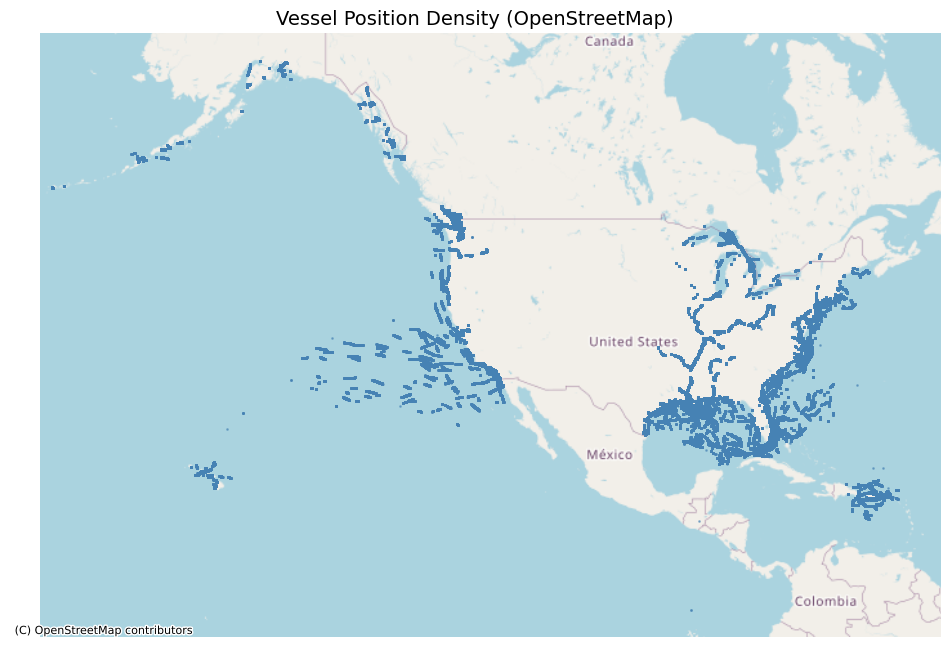

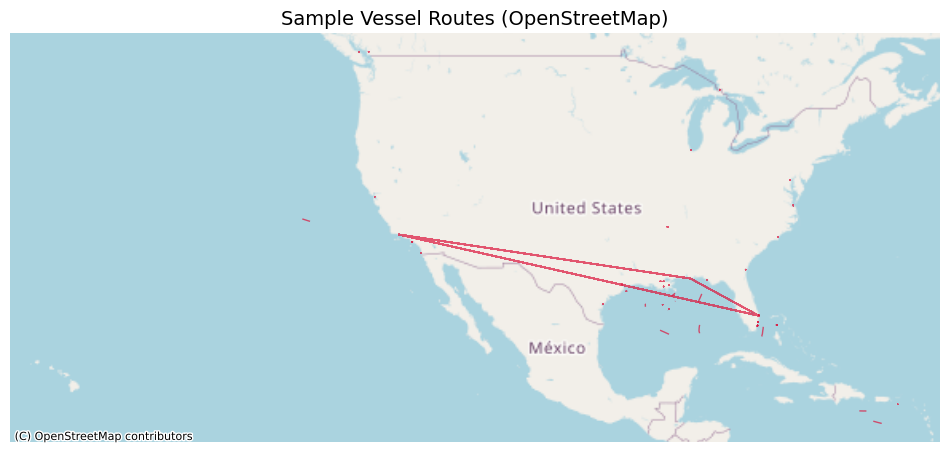

In [ ]:
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
from shapely.geometry import Point, LineString
import os

# Ensure output directory exists
os.makedirs("outputs/eda", exist_ok=True)

# ✅ Create GeoDataFrame of vessel positions
gdf = gpd.GeoDataFrame(
    all_data_sample,
    geometry=gpd.points_from_xy(all_data_sample.LON, all_data_sample.LAT),
    crs="EPSG:4326",
)

# ✅ Project to Web Mercator for plotting with basemaps
gdf_web = gdf.to_crs(epsg=3857)

# =========================
# OPTION A — Point Density Map
# =========================
fig, ax = plt.subplots(figsize=(12, 10))
gdf_web.plot(ax=ax, markersize=1, alpha=0.5, color="steelblue")

# ✅ Use OpenStreetMap as basemap
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)

ax.set_axis_off()
plt.title("Vessel Position Density (OpenStreetMap)", fontsize=14)
plt.savefig("outputs/eda/geopandas_points.png", dpi=300, bbox_inches="tight")
plt.show()


# =========================
# OPTION B — Vessel Route Samples
# =========================
routes = []
for mmsi, df in list(vessel_dict.items())[:50]:  # sample first 50 vessels
    coords = list(zip(df["LON"].astype(float), df["LAT"].astype(float)))
    if len(coords) >= 2:
        routes.append({"mmsi": mmsi, "geometry": LineString(coords)})

# ✅ Convert to GeoDataFrame
gdf_routes = gpd.GeoDataFrame(routes, crs="EPSG:4326").to_crs(epsg=3857)

fig, ax = plt.subplots(figsize=(12, 10))
gdf_routes.plot(ax=ax, linewidth=1, color="crimson", alpha=0.7)
ctx.add_basemap(ax, source=ctx.providers.OpenStreetMap.Mapnik)
ax.set_axis_off()
plt.title("Sample Vessel Routes (OpenStreetMap)", fontsize=14)
plt.savefig("outputs/eda/routes_sample.png", dpi=300, bbox_inches="tight")
plt.show()

### AIS Feature engineering
| **Task**                                                  | **Key AIS Features**                                           | **Purpose / Interpretation**                                                                                                  | **Typical Methods / Models**                                                                                                                                      |
| --------------------------------------------------------- | -------------------------------------------------------------- | ----------------------------------------------------------------------------------------------------------------------------- | ----------------------------------------------------------------------------------------------------------------------------------------------------------------- |
| **1. Trajectory prediction / Route clustering**           | `LAT`, `LON`, `SOG`, `COG`, `BaseDateTime`                     | Captures vessel kinematics over time (location, speed, direction). Used to predict next position or identify frequent routes. | - LSTM / GRU sequence models<br>- Kalman / Particle filters<br>- DBSCAN or HDBSCAN for route clustering<br>- Dynamic Time Warping (DTW) for trajectory similarity |
| **2. Anomaly detection**                                  | `SOG`, `COG`, `Heading`, `Status`                              | Detects abnormal movements or deviations from normal sailing behavior (e.g., sudden stops, illegal fishing).                  | - Isolation Forest, One-Class SVM<br>- Autoencoders<br>- Z-score or Hampel filter for speed/heading anomalies                                                     |
| **3. Vessel type classification**                         | `SOG` patterns, `Length`, `Width`, `Draft`, `TransceiverClass` | Different vessel classes (cargo, tanker, fishing, passenger) have characteristic motion and physical signatures.              | - Random Forest / XGBoost<br>- CNN on time–SOG–COG grids<br>- Clustering of motion features                                                                       |
| **4. Port call detection / Anchorage detection**          | `LAT`, `LON`, `SOG`, `Status`                                  | Identify when vessels enter/exit ports or anchorages. Low SOG + spatial clustering indicates anchoring.                       | - Density clustering (DBSCAN)<br>- Spatial grid analysis (geohash-based)<br>- Hidden Markov Models for state transitions                                          |
| **5. Collision risk assessment / encounter analysis**     | `LAT`, `LON`, `COG`, `SOG`, `Heading`                          | Estimate closest point of approach (CPA), detect near misses or congested zones.                                              | - Rule-based kinematic models<br>- Monte Carlo simulations<br>- Graph-based encounter networks                                                                    |
| **6. Maritime traffic density mapping**                   | `LAT`, `LON`, `BaseDateTime`                                   | Visualize major sea lanes, choke points, or port traffic over time.                                                           | - Kernel Density Estimation (KDE)<br>- Hexbin maps<br>- Kepler.gl / Deck.gl animations                                                                            |
| **7. Predictive ETA / Delay forecasting**                 | `SOG`, `COG`, `BaseDateTime`, route history                    | Estimate arrival time based on vessel trajectory, speed, and known routes.                                                    | - Regression models (LGBM, RF)<br>- LSTM on trajectory data<br>- Gradient-based ETA correction                                                                    |
| **8. Behavior pattern analysis (e.g., fishing activity)** | `SOG`, `COG`, `Heading`, `Status`, `Draft`                     | Recognize behavioral signatures (trawling, loitering, drifting).                                                              | - State classification (HMM)<br>- Sequence pattern mining<br>- Supervised classification with expert labels                                                       |


In [ ]:
import numpy as np
import pandas as pd
from tqdm import tqdm


def engineer_vessel_features(
    vessel_dict, sog_stop_threshold=0.5, stop_duration_min=5, rolling_window="10T"
):
    """
    Engineer time-based and kinematic features from AIS vessel data.

    Parameters
    ----------
    vessel_dict : dict
        {mmsi: pd.DataFrame} where each DF includes BaseDateTime, LAT, LON, SOG, COG, Heading.
    sog_stop_threshold : float
        Threshold in knots below which vessel is considered stationary.
    stop_duration_min : int
        Minimum consecutive minutes below threshold to count as a stop event.
    rolling_window : str
        Rolling window for smoothing (e.g. '10T' = 10 minutes).

    Returns
    -------
    dict
        Updated vessel_dict with engineered feature columns.
    """

    processed = {}

    for mmsi, df in tqdm(vessel_dict.items(), desc="Engineering features per vessel"):
        df = df.copy()
        df = df.sort_values("BaseDateTime")

        # 1️⃣ Timestamp-based features
        df["hour"] = df["BaseDateTime"].dt.hour
        df["dayofweek"] = df["BaseDateTime"].dt.dayofweek
        df["month"] = df["BaseDateTime"].dt.month
        df["is_weekend"] = df["dayofweek"] >= 5

        # 2️⃣ Convert COG degrees → radians for trigonometry
        df["COG_rad"] = np.deg2rad(df["COG"])

        # 3️⃣ Velocity vector components
        df["v_x"] = df["SOG"] * np.cos(df["COG_rad"])
        df["v_y"] = df["SOG"] * np.sin(df["COG_rad"])

        # 4️⃣ Compute time delta in hours
        df["Δt_hours"] = df["BaseDateTime"].diff().dt.total_seconds() / 3600.0

        # 5️⃣ Derive turn rate (ΔCOG / Δt)
        df["ΔCOG"] = df["COG"].diff()
        df.loc[df["ΔCOG"] > 180, "ΔCOG"] -= 360
        df.loc[df["ΔCOG"] < -180, "ΔCOG"] += 360
        df["turn_rate"] = df["ΔCOG"] / df["Δt_hours"]  # degrees per hour

        # 6️⃣ Acceleration (ΔSOG / Δt)
        df["ΔSOG"] = df["SOG"].diff()
        df["accel_knots_per_hr"] = df["ΔSOG"] / df["Δt_hours"]

        # 7️⃣ Stop detection (SOG < threshold for ≥ N minutes)
        df["is_slow"] = df["SOG"] < sog_stop_threshold
        # Group consecutive “slow” points
        df["stop_group"] = (df["is_slow"] != df["is_slow"].shift()).cumsum()
        stop_durations = df.groupby("stop_group")["BaseDateTime"].agg(
            lambda x: (x.max() - x.min()).total_seconds() / 60
        )
        stop_flags = stop_durations[stop_durations >= stop_duration_min].index
        df["is_stopped"] = df["stop_group"].isin(stop_flags)
        df.drop(columns=["stop_group"], inplace=True)

        # 8️⃣ Rolling smoothing for noisy signals
        roll_cols = ["SOG", "COG", "Heading", "turn_rate", "accel_knots_per_hr"]
        df_rolled = (
            df.set_index("BaseDateTime")[roll_cols]
            .rolling(rolling_window, min_periods=1)
            .mean()
            .add_suffix("_smooth")
        )
        df = pd.concat([df.set_index("BaseDateTime"), df_rolled], axis=1).reset_index()

        processed[mmsi] = df

    return processed


# Example usage:
vessel_dict_enriched = engineer_vessel_features(vessel_dict)

Engineering features per vessel:   0%|          | 0/11822 [00:00<?, ?it/s]C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWarning:

'T' is deprecated and will be removed in a future version, please use 'min' instead.

C:\Users\amans\AppData\Local\Temp\ipykernel_28536\1474683568.py:69: FutureWa

### Note: The above code.

| Feature                           | Meaning                             | Use Cases                                |
| --------------------------------- | ----------------------------------- | ---------------------------------------- |
| `hour`, `dayofweek`, `is_weekend` | Temporal context                    | Diurnal or weekly traffic analysis       |
| `v_x`, `v_y`                      | Vectorized velocity                 | Motion clustering, trajectory prediction |
| `turn_rate`                       | Angular rate of change (°/hr)       | Maneuver or anomaly detection            |
| `accel_knots_per_hr`              | Acceleration                        | Behavior classification                  |
| `is_stopped`                      | Binary flag for anchoring/port call | Port detection, idle analysis            |
| `*_smooth`                        | Rolling mean smoothed signals       | Stable inputs for ML models              |


In [33]:
vessel_dict_enriched

{11:          BaseDateTime  MMSI       LAT       LON  SOG    COG  Heading  \
 0 2020-01-01 01:02:21    11  27.29223 -90.96779  0.0  234.4      511   
 
   VesselName  IMO CallSign  ...  turn_rate  ΔSOG  accel_knots_per_hr  is_slow  \
 0        NaN  NaN      NaN  ...        NaN   NaN                 NaN     True   
 
    is_stopped  SOG_smooth COG_smooth  Heading_smooth  turn_rate_smooth  \
 0       False         0.0      234.4           511.0               NaN   
 
    accel_knots_per_hr_smooth  
 0                        NaN  
 
 [1 rows x 36 columns],
 18:           BaseDateTime  MMSI       LAT       LON  SOG    COG  Heading  \
 0  2020-01-01 00:00:28    18  27.85057 -97.23631  0.0  215.1      511   
 1  2020-01-01 00:03:32    18  27.85055 -97.23627  0.0  201.0      511   
 2  2020-01-01 00:06:32    18  27.85056 -97.23627  0.0  189.3      511   
 3  2020-01-01 00:09:32    18  27.85054 -97.23624  0.0  193.6      511   
 4  2020-01-01 00:12:31    18  27.85055 -97.23633  0.0  206.8     

In [ ]:
# Combine all vessels into a single DataFrame
all_vessels_df = pd.concat(vessel_dict_enriched.values(), ignore_index=True)
print(all_vessels_df.shape)
all_vessels_df.head()

(1048575, 36)


,BaseDateTime,MMSI,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,...,turn_rate,ΔSOG,accel_knots_per_hr,is_slow,is_stopped,SOG_smooth,COG_smooth,Heading_smooth,turn_rate_smooth,accel_knots_per_hr_smooth
0,2020-01-01 01:02:21,11,27.29223,-90.96779,0.0,234.4,511,NaN,NaN,NaN,...,NaN,NaN,NaN,True,False,0.0,234.40,511.0,NaN,NaN
1,2020-01-01 00:00:28,18,27.85057,-97.23631,0.0,215.1,511,NaN,NaN,NaN,...,NaN,NaN,NaN,True,True,0.0,215.10,511.0,NaN,NaN
2,2020-01-01 00:03:32,18,27.85055,-97.23627,0.0,201.0,511,NaN,NaN,NaN,...,-275.869565,0.0,0.0,True,True,0.0,208.05,511.0,-275.869565,0.0
3,2020-01-01 00:06:32,18,27.85056,-97.23627,0.0,189.3,511,NaN,NaN,NaN,...,-234.000000,0.0,0.0,True,True,0.0,201.80,511.0,-254.934783,0.0
4,2020-01-01 00:09:32,18,27.85054,-97.23624,0.0,193.6,511,NaN,NaN,NaN,...,86.000000,0.0,0.0,True,True,0.0,199.75,511.0,-141.289855,0.0


### Histograms of Key Dynamic Features
Speed Over Ground (SOG) Histogram

A histogram of SOG reveals the distribution of vessel speeds. In maritime traffic, most vessels operate at cruising speeds, with peaks often around 10–15 knots. A bimodal distribution might indicate the presence of both high-speed vessels (e.g., ferries) and low-speed vessels (e.g., fishing boats).

Source: ResearchGate

Turn Rate Histogram

The turn rate histogram shows how frequently vessels change their heading. Sharp turns (high turn rates) might indicate maneuvering in congested areas, while low turn rates suggest steady courses. A concentration near zero indicates predominantly straight-line navigation.

Acceleration Histogram

Acceleration histograms highlight how quickly vessels change speed. Frequent accelerations can be seen in areas with high traffic density, while low acceleration indicates steady cruising. Spikes in acceleration might point to sudden maneuvers or anomalies.

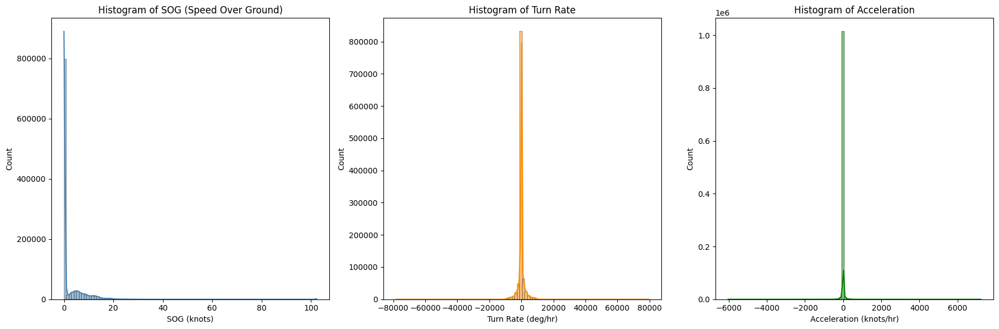

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(18, 6))

# 1️⃣ SOG
plt.subplot(1, 3, 1)
sns.histplot(all_vessels_df["SOG"], bins=100, kde=True, color="steelblue")
plt.title("Histogram of SOG (Speed Over Ground)")
plt.xlabel("SOG (knots)")

# 2️⃣ Turn Rate
plt.subplot(1, 3, 2)
sns.histplot(all_vessels_df["turn_rate"], bins=100, kde=True, color="darkorange")
plt.title("Histogram of Turn Rate")
plt.xlabel("Turn Rate (deg/hr)")

# 3️⃣ Acceleration
plt.subplot(1, 3, 3)
sns.histplot(all_vessels_df["accel_knots_per_hr"], bins=100, kde=True, color="green")
plt.title("Histogram of Acceleration")
plt.xlabel("Acceleration (knots/hr)")

plt.tight_layout()
plt.show()

### SOG Heatmap:
 This heatmap visualizes the average SOG for each hour of the day. It helps identify peak traffic times and potential congestion periods. For instance, higher SOG during certain hours might indicate peak traffic, while lower SOG could suggest off-peak times or anchorage.

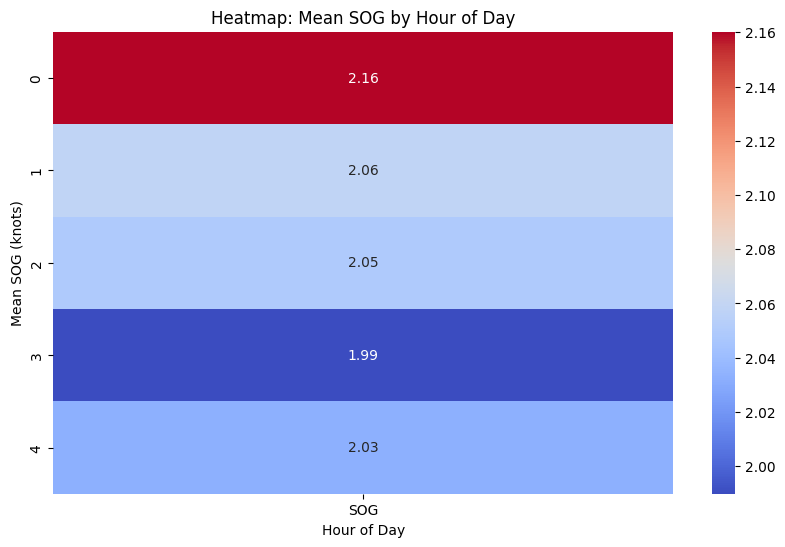

In [ ]:
# Pivot table: mean SOG by hour
hourly_sog = all_vessels_df.groupby("hour")["SOG"].mean().reset_index()

plt.figure(figsize=(10, 6))
sns.heatmap(
    hourly_sog.pivot_table(index="hour", values="SOG"),
    annot=True,
    cmap="coolwarm",
    fmt=".2f",
)
plt.title("Heatmap: Mean SOG by Hour of Day")
plt.xlabel("Hour of Day")
plt.ylabel("Mean SOG (knots)")
plt.show()

### Interpretation:

Higher SOG during certain hours → peak traffic.

Low SOG → off-peak or port approach/anchoring periods.

Can detect diurnal patterns in vessel movements.

### Scatter Map of Velocity Vectors

In [ ]:
plt.figure(figsize=(20, 18), dpi=500)
sns.scatterplot(
    x=all_vessels_df["v_x"],
    y=all_vessels_df["v_y"],
    hue=all_vessels_df["hour"],
    palette="viridis",
    alpha=0.6,
    s=25,
)
plt.title("Scatter of Velocity Vectors (v_x vs v_y)")
plt.xlabel("v_x (knots)")
plt.ylabel("v_y (knots)")
plt.legend(title="Hour of Day", bbox_to_anchor=(1.05, 1), loc="upper left")
plt.axis("equal")
plt.show()

In [43]:
all_vessels_df

,BaseDateTime,MMSI,LAT,LON,SOG,COG,Heading,VesselName,IMO,CallSign,...,turn_rate,ΔSOG,accel_knots_per_hr,is_slow,is_stopped,SOG_smooth,COG_smooth,Heading_smooth,turn_rate_smooth,accel_knots_per_hr_smooth
0,2020-01-01 01:02:21,11,27.29223,-90.96779,0.0,234.4,511,NaN,NaN,NaN,...,NaN,NaN,NaN,True,False,0.000000,234.400000,511.0,NaN,NaN
1,2020-01-01 00:00:28,18,27.85057,-97.23631,0.0,215.1,511,NaN,NaN,NaN,...,NaN,NaN,NaN,True,True,0.000000,215.100000,511.0,NaN,NaN
2,2020-01-01 00:03:32,18,27.85055,-97.23627,0.0,201.0,511,NaN,NaN,NaN,...,-275.869565,0.0,0.0,True,True,0.000000,208.050000,511.0,-275.869565,0.000000
3,2020-01-01 00:06:32,18,27.85056,-97.23627,0.0,189.3,511,NaN,NaN,NaN,...,-234.000000,0.0,0.0,True,True,0.000000,201.800000,511.0,-254.934783,0.000000
4,2020-01-01 00:09:32,18,27.85054,-97.23624,0.0,193.6,511,NaN,NaN,NaN,...,86.000000,0.0,0.0,True,True,0.000000,199.750000,511.0,-141.289855,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1048570,2020-01-01 04:08:40,1073709206,29.94072,-91.84221,0.0,346.9,511,RAM 14,IMO8765072,WDA6950,...,324.000000,-0.1,-4.0,True,True,0.062500,329.500000,511.0,226.948619,-0.509054
1048571,2020-01-01 04:09:43,1073709206,29.94075,-91.84231,0.0,332.1,511,RAM 14,IMO8765072,WDA6950,...,-845.714286,0.0,0.0,True,True,0.055556,329.788889,511.0,107.763852,-0.452493
1048572,2020-01-01 04:10:49,1073709206,29.94076,-91.84231,0.0,321.7,511,RAM 14,IMO8765072,WDA6950,...,-567.272727,0.0,0.0,True,True,0.044444,331.344444,511.0,49.533549,-0.452493
1048573,2020-01-01 04:12:30,1073709206,29.94076,-91.84231,0.0,327.9,511,RAM 14,IMO8765072,WDA6950,...,220.990099,0.0,0.0,True,True,0.050000,334.175000,511.0,-39.436710,0.133803


In [44]:
all_vessels_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 36 columns):
 #   Column                     Non-Null Count    Dtype         
---  ------                     --------------    -----         
 0   BaseDateTime               1048575 non-null  datetime64[ns]
 1   MMSI                       1048575 non-null  int64         
 2   LAT                        1048575 non-null  float64       
 3   LON                        1048575 non-null  float64       
 4   SOG                        1048575 non-null  float64       
 5   COG                        1048575 non-null  float64       
 6   Heading                    1048575 non-null  int64         
 7   VesselName                 957221 non-null   object        
 8   IMO                        448711 non-null   object        
 9   CallSign                   863249 non-null   object        
 10  VesselType                 942832 non-null   float64       
 11  Status                     818750 non

In [46]:
all_vessels_df.columns

Index(['BaseDateTime', 'MMSI', 'LAT', 'LON', 'SOG', 'COG', 'Heading',
       'VesselName', 'IMO', 'CallSign', 'VesselType', 'Status', 'Length',
       'Width', 'Draft', 'Cargo', 'TransceiverClass', 'hour', 'dayofweek',
       'month', 'is_weekend', 'COG_rad', 'v_x', 'v_y', 'Δt_hours', 'ΔCOG',
       'turn_rate', 'ΔSOG', 'accel_knots_per_hr', 'is_slow', 'is_stopped',
       'SOG_smooth', 'COG_smooth', 'Heading_smooth', 'turn_rate_smooth',
       'accel_knots_per_hr_smooth'],
      dtype='object')

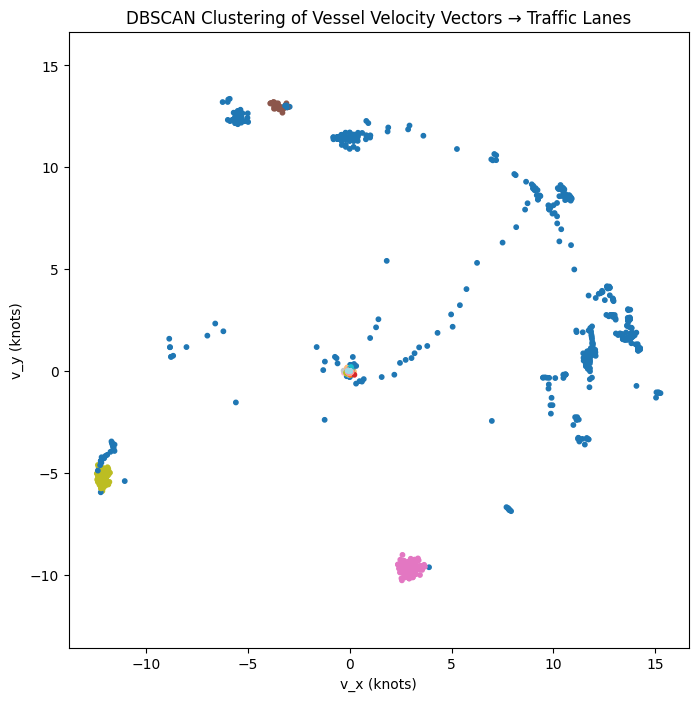

In [ ]:
from sklearn.cluster import DBSCAN
import numpy as np

# Example: use all velocity vectors for a sample of vessels
sample_df = pd.concat(list(vessel_dict_enriched.values())[:50], ignore_index=True)

# Prepare features for clustering
X = sample_df[["LAT", "LON", "v_x", "v_y"]].values

# Run DBSCAN
db = DBSCAN(
    eps=0.5, min_samples=50
)  # eps: distance in knots, min_samples: points per lane
labels = db.fit_predict(X)

sample_df["lane_cluster"] = labels

# Plot clustered lanes
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 8))
plt.scatter(
    sample_df["v_x"], sample_df["v_y"], c=sample_df["lane_cluster"], cmap="tab20", s=10
)
plt.xlabel("v_x (knots)")
plt.ylabel("v_y (knots)")
plt.title("DBSCAN Clustering of Vessel Velocity Vectors → Traffic Lanes")
plt.axis("equal")
plt.show()

Clusters represent dominant shipping lanes.

Noise points (label -1) → irregular movements, possible anomalies or off-route vessels.

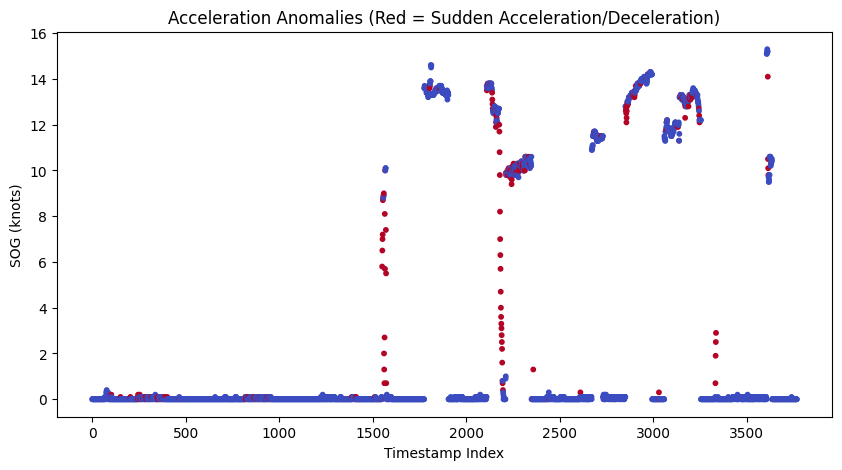

In [ ]:
# Thresholds for anomaly detection
accel_threshold = 5.0  # knots/hr
turn_rate_threshold = 45  # degrees/hr

sample_df["accel_anomaly"] = sample_df["accel_knots_per_hr"].abs() > accel_threshold
sample_df["turn_anomaly"] = sample_df["turn_rate"].abs() > turn_rate_threshold

# Highlight anomalies
plt.figure(figsize=(10, 5))
plt.scatter(
    sample_df.index,
    sample_df["SOG"],
    c=sample_df["accel_anomaly"],
    cmap="coolwarm",
    s=10,
)
plt.title("Acceleration Anomalies (Red = Sudden Acceleration/Deceleration)")
plt.xlabel("Timestamp Index")
plt.ylabel("SOG (knots)")
plt.show()

In [ ]:
# Example: assume ports are circles around coordinates (lat, lon, radius_km)
# Port Call Detection Using Low SOG + Geofencing
from geopy.distance import geodesic

ports = {"Port of Mumbai": (18.95, 72.82), "Port of Rotterdam": (51.95, 4.13)}


def detect_port_calls(df, sog_thresh=0.5, stop_duration_min=10):
    df["at_port"] = False
    for port_name, port_coord in ports.items():
        df["dist_to_port"] = df.apply(
            lambda row: geodesic((row.LAT, row.LON), port_coord).km, axis=1
        )
        df["at_port"] |= (df["dist_to_port"] < 1.0) & (df["SOG"] < sog_thresh)
    return df


sample_df = detect_port_calls(sample_df)
print(sample_df[["MMSI", "LAT", "LON", "SOG", "at_port"]].head())

   MMSI       LAT       LON  SOG  at_port
0    11  27.29223 -90.96779  0.0    False
1    18  27.85057 -97.23631  0.0    False
2    18  27.85055 -97.23627  0.0    False
3    18  27.85056 -97.23627  0.0    False
4    18  27.85054 -97.23624  0.0    False


In [ ]:
import folium
from folium.plugins import TimestampedGeoJson

m = folium.Map(location=[sample_df.LAT.mean(), sample_df.LON.mean()], zoom_start=5)

features = []
for _, row in sample_df.iterrows():
    features.append(
        {
            "type": "Feature",
            "geometry": {"type": "Point", "coordinates": [row["LON"], row["LAT"]]},
            "properties": {
                "time": row["BaseDateTime"].isoformat(),
                "popup": f"SOG: {row['SOG']:.1f}",
            },
        }
    )

TimestampedGeoJson(
    {"type": "FeatureCollection", "features": features},
    period="PT5M",
    add_last_point=True,
    auto_play=False,
    loop=False,
).add_to(m)

m.save("outputs/animated_vessel_flow_2020_01_01.html")

In [ ]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler

# Example: select one MMSI for demo
mmsi_example = 1073709206  # replace with a real MMSI from your dataset
df_vessel = all_vessels_df[all_vessels_df["MMSI"] == mmsi_example].sort_values(
    "BaseDateTime"
)

# Features to predict
features = ["LAT", "LON", "SOG", "COG", "v_x", "v_y"]

# Scale features
scaler = MinMaxScaler()
df_vessel_scaled = pd.DataFrame(
    scaler.fit_transform(df_vessel[features]), columns=features
)


# Sequence preparation for LSTM
def create_sequences(data, seq_length=30):
    X, y = [], []
    for i in range(len(data) - seq_length):
        X.append(data[i : i + seq_length])
        y.append(data[i + seq_length])
    return np.array(X), np.array(y)


seq_length = 10  # last 30 timesteps to predict next
X, y = create_sequences(df_vessel_scaled.values, seq_length=seq_length)

# Train/test split (80/20 sequential)
split = int(0.8 * len(X))
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]

print("X_train shape:", X_train.shape)
print("y_train shape:", y_train.shape)

X_train shape: (115, 10, 6)
y_train shape: (115, 6)


In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout

model = Sequential(
    [
        LSTM(
            64, input_shape=(X_train.shape[1], X_train.shape[2]), return_sequences=False
        ),
        Dropout(0.2),
        Dense(len(features)),  # predict all features at next timestep
    ]
)

model.compile(optimizer="adam", loss="mse")
model.summary()

# Train
history = model.fit(
    X_train, y_train, epochs=20, batch_size=64, validation_data=(X_test, y_test)
)

d:\Maritime_Vessel_monitoring\Maritime_analytics_AIS_System\maais\Lib\site-packages\keras\src\layers\rnn\rnn.py:199: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ lstm (LSTM)                     │ (None, 64)             │        18,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 64)             │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 6)              │           390 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 18,566 (72.52 KB)

 Trainable params: 18,566 (72.52 KB)

 Non-trainable params: 0 (0.00 B)

Epoch 1/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 2s 247ms/step - loss: 0.3450 - val_loss: 0.3568
Epoch 2/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.2834 - val_loss: 0.2968
Epoch 3/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.2362 - val_loss: 0.2445
Epoch 4/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.1896 - val_loss: 0.1994
Epoch 5/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.1512 - val_loss: 0.1622
Epoch 6/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.1264 - val_loss: 0.1341
Epoch 7/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.1096 - val_loss: 0.1159
Epoch 8/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step - loss: 0.1049 - val_loss: 0.1055
Epoch 9/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.0957 - val_loss: 0.0999
Epoch 10/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0961 - val_loss: 0.0962
Epoch 11/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.0888 - val_loss: 0.0935
Epoch 12/20
2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0961 - val_loss: 0.0924


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


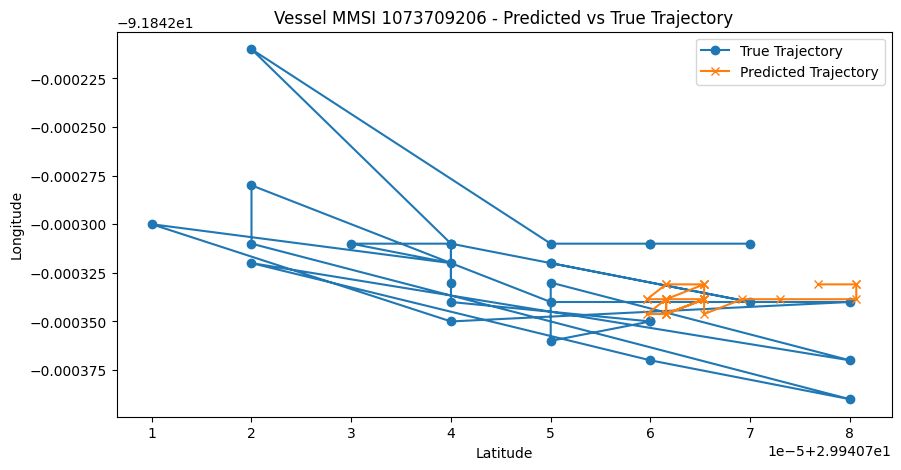

In [ ]:
import matplotlib.pyplot as plt

# Predict
y_pred = model.predict(X_test)

# Inverse transform
y_test_inv = scaler.inverse_transform(y_test)
y_pred_inv = scaler.inverse_transform(y_pred)

# Plot for LAT/LON
plt.figure(figsize=(10, 5))
plt.plot(y_test_inv[:100, 0], y_test_inv[:100, 1], label="True Trajectory", marker="o")
plt.plot(
    y_pred_inv[:100, 0], y_pred_inv[:100, 1], label="Predicted Trajectory", marker="x"
)
plt.xlabel("Latitude")
plt.ylabel("Longitude")
plt.title(f"Vessel MMSI {mmsi_example} - Predicted vs True Trajectory")
plt.legend()
plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 133ms/step


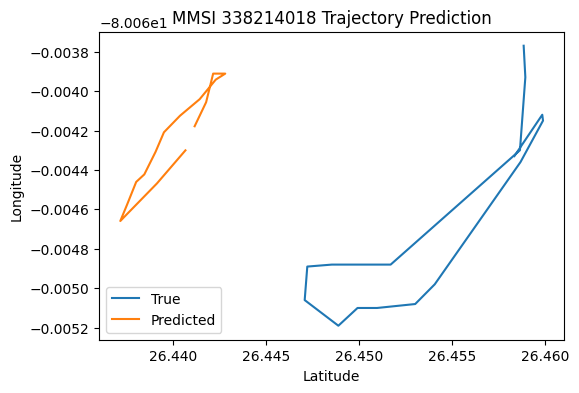

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


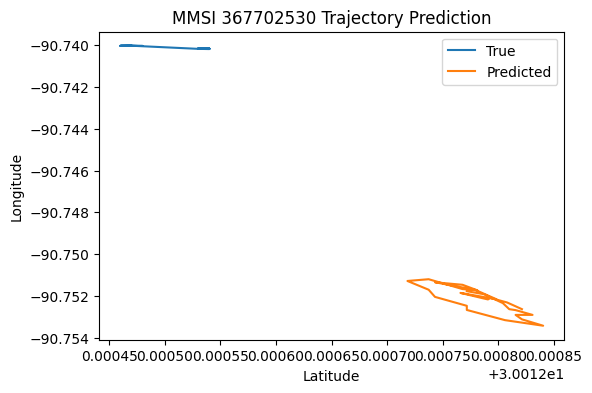

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


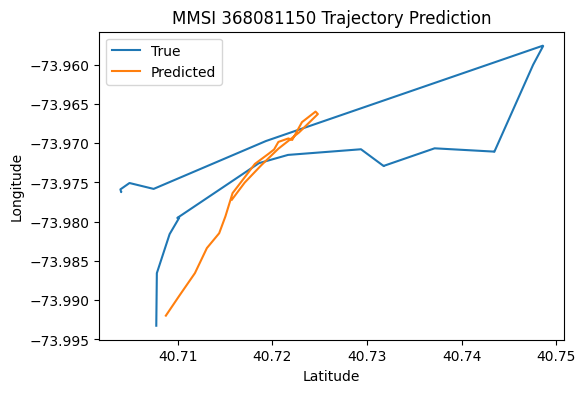

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


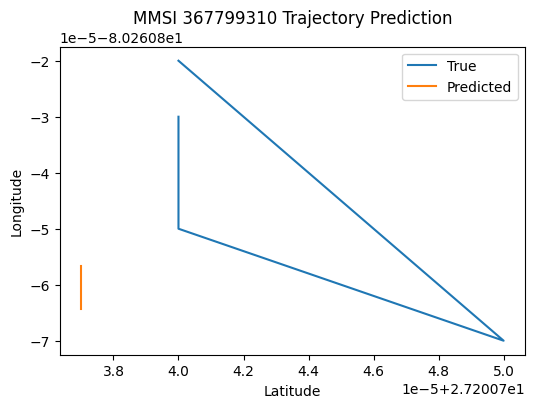

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


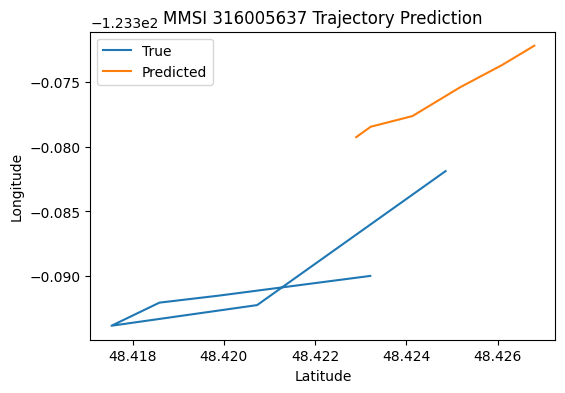

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


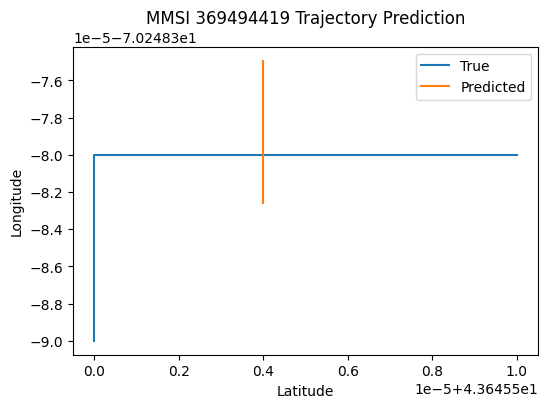

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/step


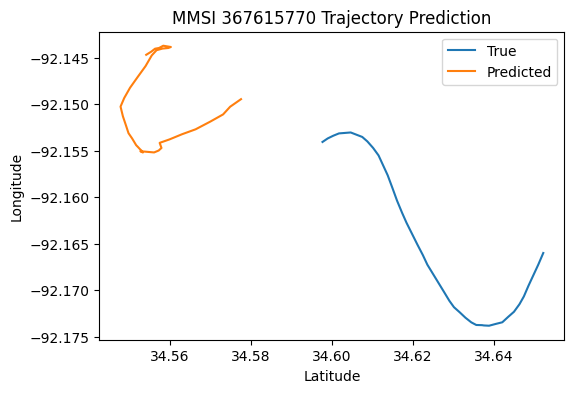

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


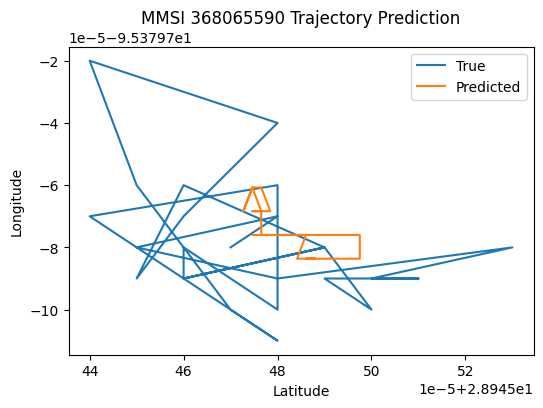

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


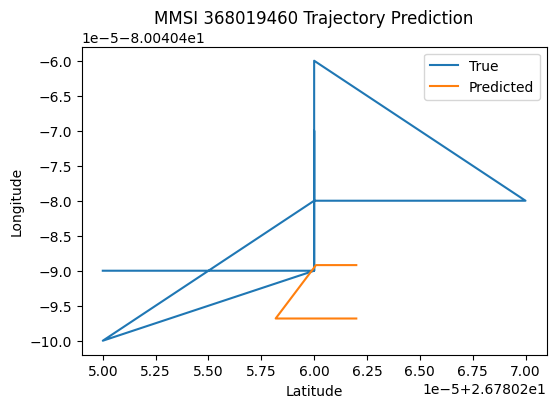

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


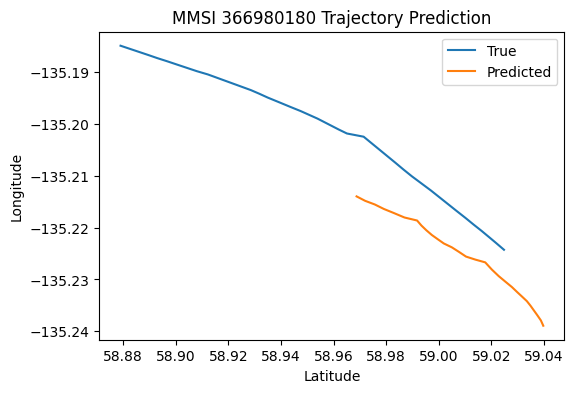

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


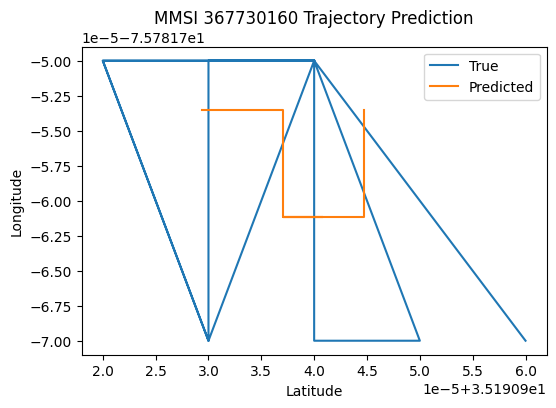

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


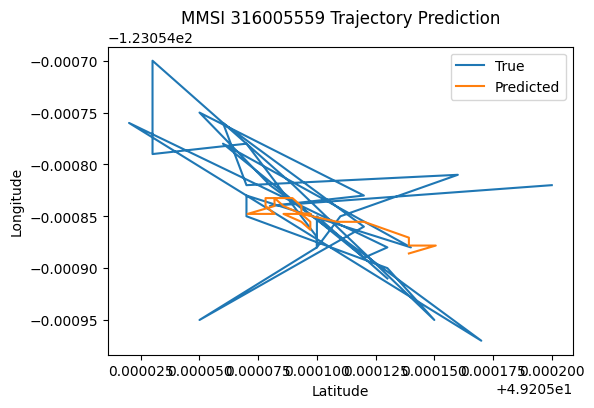

ValueError: Exception encountered when calling Sequential.call().

[1mCannot take the length of shape with unknown rank.[0m

Arguments received by Sequential.call():
  • inputs=tf.Tensor(shape=<unknown>, dtype=float32)
  • training=True
  • mask=None
  • kwargs=<class 'inspect._empty'>

In [ ]:
import random

sample_mmsis = random.sample(all_vessels_df["MMSI"].unique().tolist(), 20)

for mmsi in sample_mmsis:
    df_vessel = all_vessels_df[all_vessels_df["MMSI"] == mmsi].sort_values(
        "BaseDateTime"
    )
    df_vessel_scaled = pd.DataFrame(
        scaler.fit_transform(df_vessel[features]), columns=features
    )
    X, y = create_sequences(df_vessel_scaled.values, seq_length=seq_length)
    split = int(0.8 * len(X))
    X_train, X_test = X[:split], X[split:]
    y_train, y_test = y[:split], y[split:]

    model.fit(X_train, y_train, epochs=10, batch_size=64, verbose=0)

    y_pred = model.predict(X_test)
    y_test_inv = scaler.inverse_transform(y_test)
    y_pred_inv = scaler.inverse_transform(y_pred)

    plt.figure(figsize=(6, 4))
    plt.plot(y_test_inv[:, 0], y_test_inv[:, 1], label="True")
    plt.plot(y_pred_inv[:, 0], y_pred_inv[:, 1], label="Predicted")
    plt.title(f"MMSI {mmsi} Trajectory Prediction")
    plt.xlabel("Latitude")
    plt.ylabel("Longitude")
    plt.legend()
    plt.show()